#A. Proszę porównać metody Harrisa, SIFT, SURF, FAST i ORB w zadaniu rozpoznawania punktów charakterystycznych dla obrazu lab5_2.png. Dla której metody wyniki wydają się bliższe intuicji? Która wydaje się być bardziej „aplikowalna” (np. ze względu na czas obliczeń)?

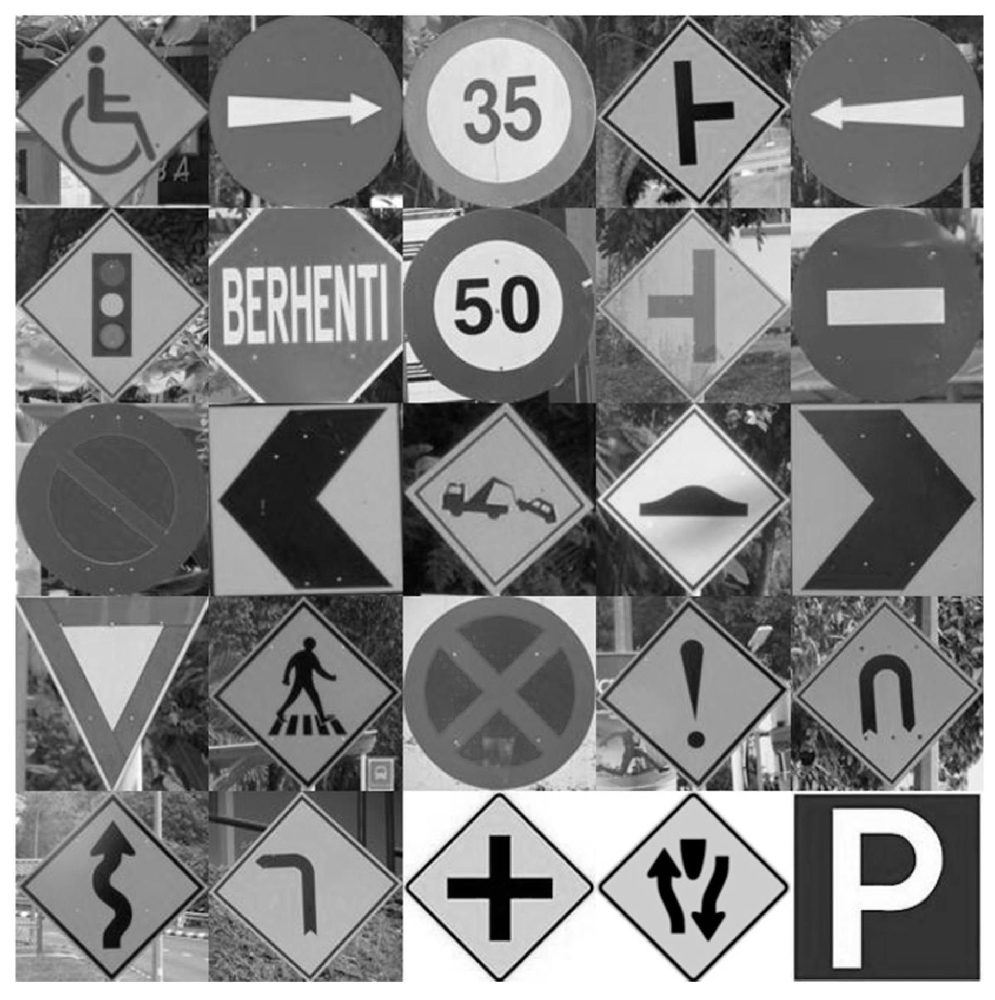

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/AiPO/lab5_2.png')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)

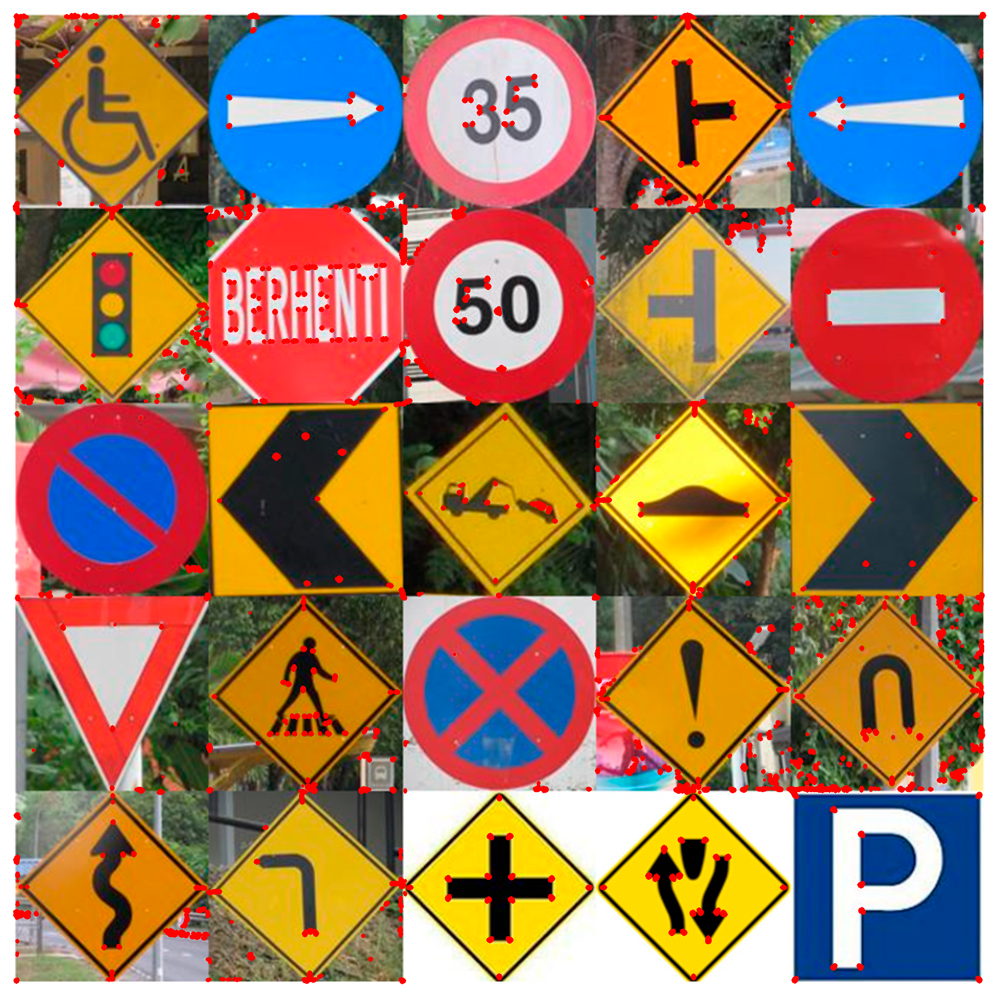

In [ ]:
import numpy as np
# Metoda Harrisa
harris = cv2.cornerHarris(gray, 7, 9, 0.07)
keypoints_harris = np.argwhere(harris > 0.01 * harris.max())
keypoints_harris = [cv2.KeyPoint(float(x[1]), float(x[0]), 2) for x in keypoints_harris]


img_harris = cv2.drawKeypoints(img.copy(), keypoints_harris, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
for point in keypoints_harris:
    cv2.circle(img_harris, (int(point.pt[0]), int(point.pt[1])), 3, (0, 0, 255), thickness=-1)

cv2_imshow(img_harris)

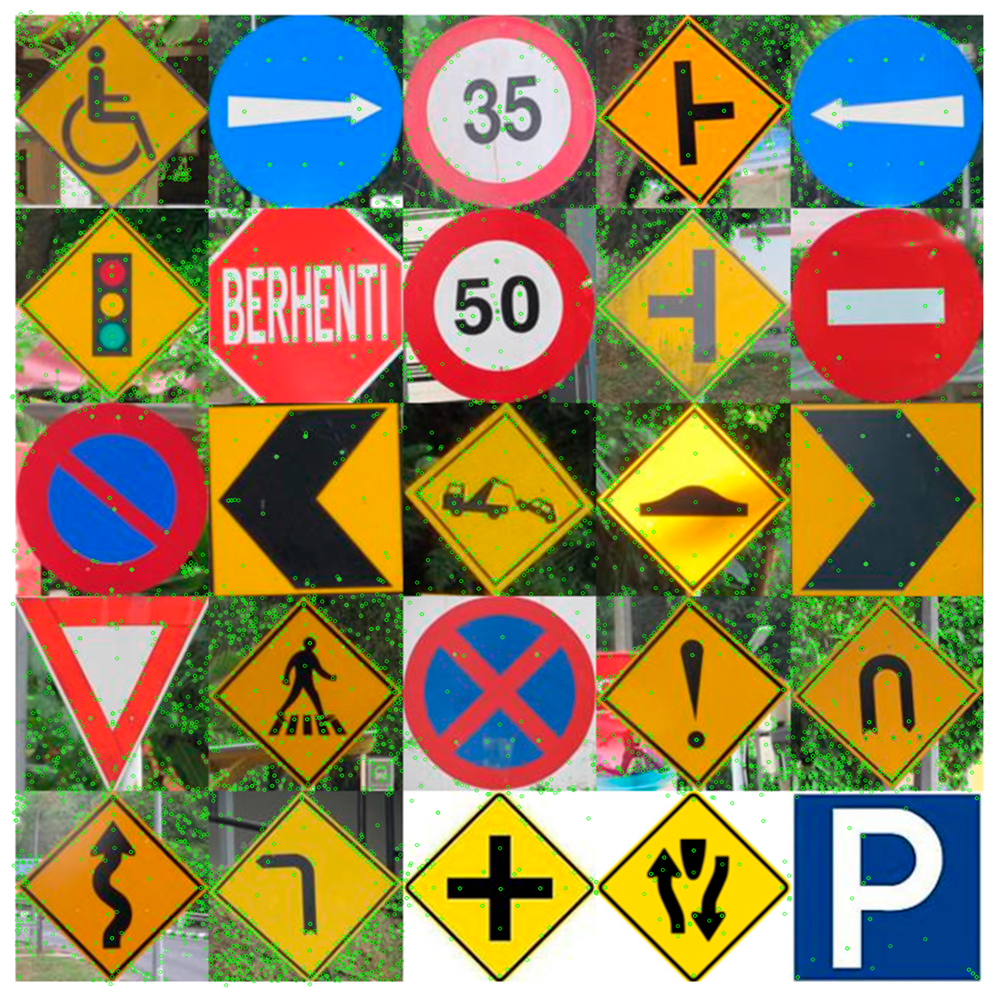

In [ ]:
# Metoda SIFT
sift = cv2.xfeatures2d.SIFT_create()
keypoints_sift = sift.detect(gray, None)

img_sift = img.copy()

cv2.drawKeypoints(img_sift, keypoints_sift, img_sift, color=(0,255,0))

cv2_imshow(img_sift)

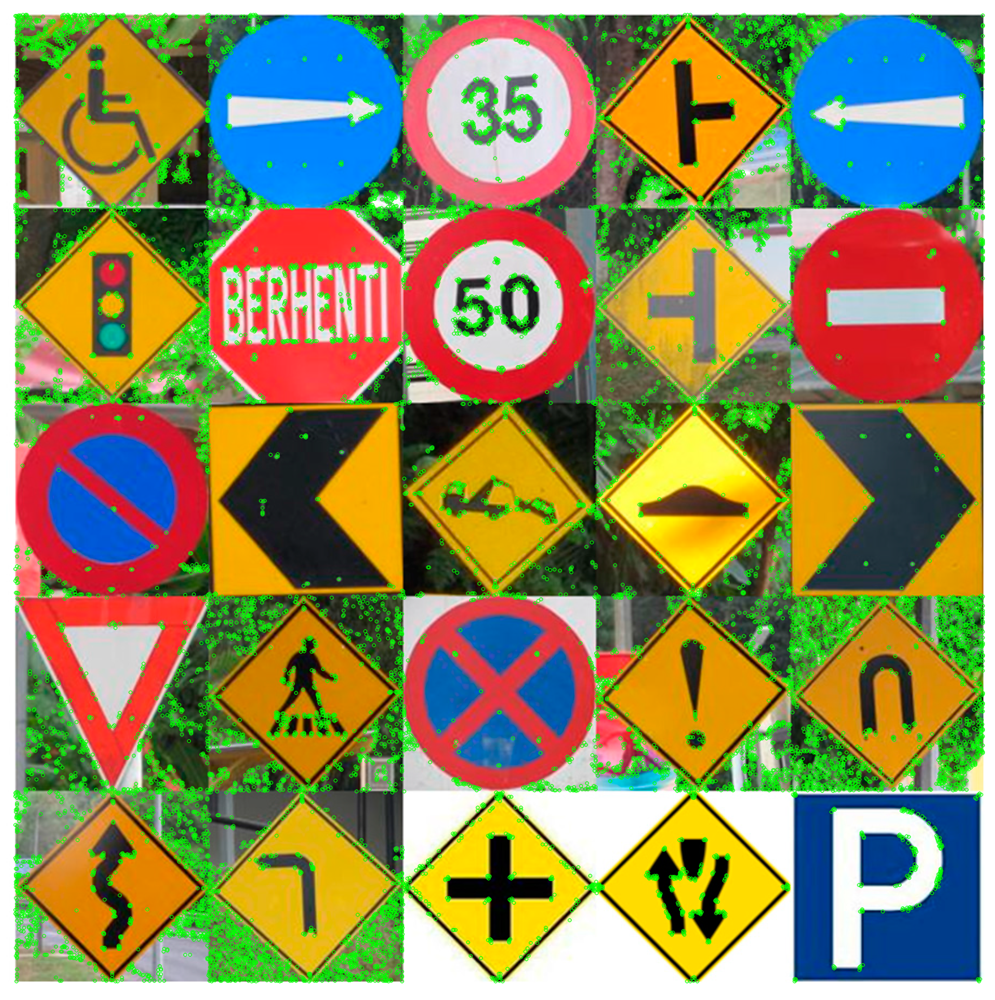

In [ ]:
# Metoda FAST
fast = cv2.FastFeatureDetector_create()
keypoints_fast = fast.detect(gray, None)


img_fast = img.copy()
cv2.drawKeypoints(img_fast, keypoints_fast, img_fast, color=(0,255,0))

cv2_imshow(img_fast)

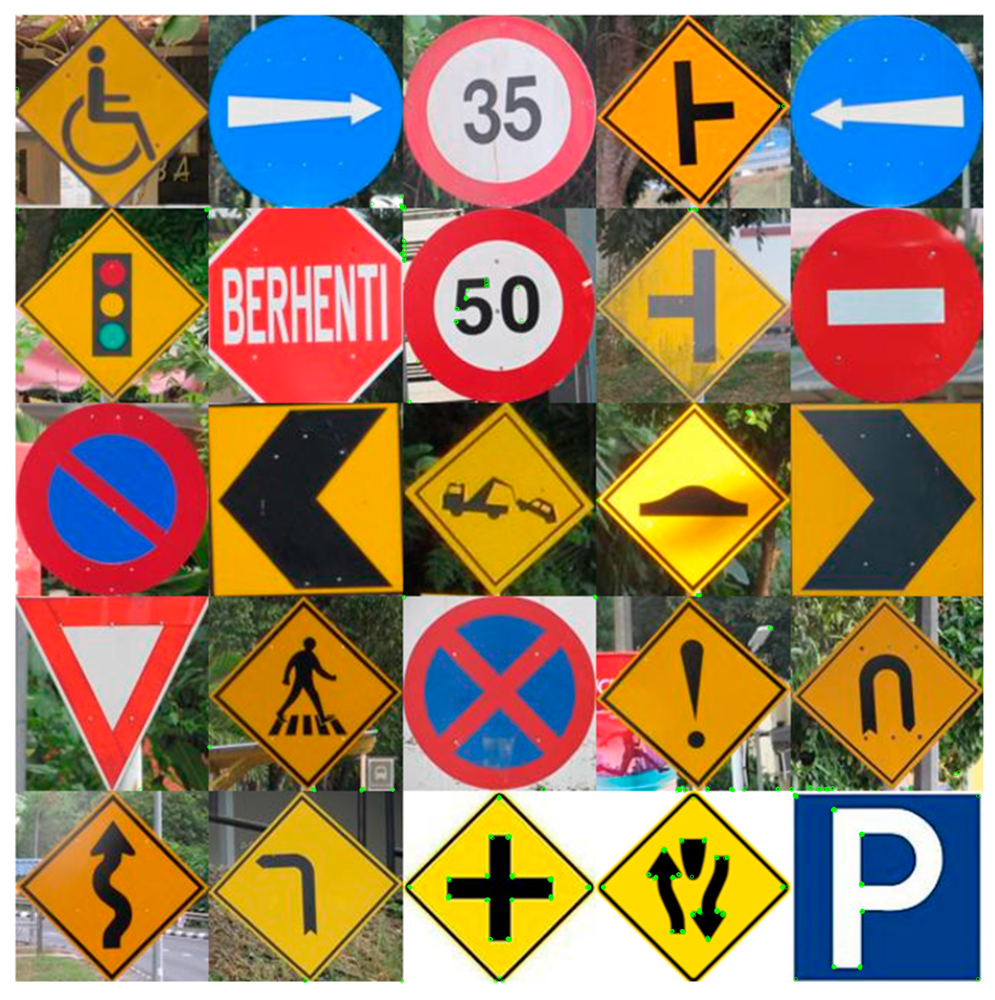

In [ ]:
# Metoda ORB
orb = cv2.ORB_create()
keypoints_orb, descriptors = orb.detectAndCompute(gray, None)
img_orb = img.copy()

cv2.drawKeypoints(img_orb, keypoints_orb, img_orb, color=(0,255,0))
cv2_imshow(img_orb)

1.    Metoda Harrisa opiera się na wykrywaniu krawędzi w obrazie i analizie zmiany intensywności wokół krawędzi. Metoda ta jest szybka, ale może mieć trudności z wykrywaniem punktów charakterystycznych na obrazach o dużym szumie.

2.    SIFT to metoda wykrywania punktów charakterystycznych, która działa na wielu skalach. Ta metoda jest odporna na zmiany skali i rotacje, ale może być kosztowna obliczeniowo.

3.    FAST to szybka metoda wykrywania punktów charakterystycznych polegająca na wykrywaniu pikseli, które mają wartości intensywności znacznie różniące się od ich sąsiadów. Metoda powinna być skuteczna na obrazach o niskim szumie.

4.    ORB to połączenie algorytmów FAST i BRIEF. Umożliwia szybkie i skuteczne wykrywanie punktów charakterystycznych. ORB może działać na wielu skalach i jest odporny na zmiany rotacji.


Patrząc na uzyskane wyniki, najlepiej sprawdziła się metoda Harrisa (pod względem wizualnym). Zaznaczyła ona najlepiej charakterystyczne punkty. Miała jednak problem z łączeniami obrazków. Metody FAST i SIFT zaznaczyły zdecydowanie zbyt dużo punktów. Może to być spowodowane zaszumieniem obrazka w kilku miejscach. ORB dla kilku części obrazka poradziło sobie dobrze, jednak dla większości obrazka nie potrafiło znaleźć punktów szczególnych.

#B. Proszę spróbować wykryć twarz w sekwencji wideo – nagranej na kamerze lub ściągniętej z serwisu youtube. W tym celu korzystamy z kaskady Haara:

In [ ]:
!pip install pytube

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.2/57.2 kB 3.6 MB/s eta 0:00:00


In [ ]:
from pytube import YouTube

yt = YouTube('https://www.youtube.com/watch?v=ZOdT17E8PZI')
stream = yt.streams.filter(file_extension='mp4', res='720p').first()
stream.download()

# Wczytanie wideo i kaskady Haara
cap = cv2.VideoCapture('/content/Ronaldo Siuuu.mp4')
face_cascade = cv2.CascadeClassifier('/content/drive/MyDrive/AiPO/haarcascade_frontalface_default.xml')

# Odczytanie parametrów wideo
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Utworzenie obiektu do zapisu wideo
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('output.mp4', fourcc, fps, (width, height))


# Wykrywanie twarzy w sekwencji wideo
while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, 1.1, 4)

    # Zakreślenie twarzy ramką
    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
    out.write(frame)


cap.release()
out.release()
cv2.destroyAllWindows()